# Import from libraries

In [1]:
import tensorflow as tf        
import matplotlib.pyplot as plt
import numpy as np

# Trained convolutional neural network loading

In [2]:
base_model = tf.keras.applications.InceptionV3(include_top=False, weights='imagenet')

2021-12-09 23:59:10.220118: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-12-09 23:59:10.328441: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-12-09 23:59:10.329108: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-12-09 23:59:10.330309: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compil

87924736/87910968 [==============================] - 1s 0us/step


In [3]:
base_model.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 3 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, None, None, 3 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, None, None, 3 0           batch_normalization[0][0]        
_______________________________________________________________________________________

In [4]:
len(base_model.layers)

311

In [5]:
names = ['mixed3', 'mixed5', 'mixed8', 'mixed9'] 

In [6]:
base_model.input

<KerasTensor: shape=(None, None, None, 3) dtype=float32 (created by layer 'input_1')>

In [7]:
layers = [base_model.get_layer(nome).output for nome in names]
layers

[<KerasTensor: shape=(None, None, None, 768) dtype=float32 (created by layer 'mixed3')>,
 <KerasTensor: shape=(None, None, None, 768) dtype=float32 (created by layer 'mixed5')>,
 <KerasTensor: shape=(None, None, None, 1280) dtype=float32 (created by layer 'mixed8')>,
 <KerasTensor: shape=(None, None, None, 2048) dtype=float32 (created by layer 'mixed9')>]

In [8]:
deep_dream_model = tf.keras.Model(inputs = base_model.input, outputs = layers)

In [9]:
deep_dream_model.output

[<KerasTensor: shape=(None, None, None, 768) dtype=float32 (created by layer 'mixed3')>,
 <KerasTensor: shape=(None, None, None, 768) dtype=float32 (created by layer 'mixed5')>,
 <KerasTensor: shape=(None, None, None, 1280) dtype=float32 (created by layer 'mixed8')>,
 <KerasTensor: shape=(None, None, None, 2048) dtype=float32 (created by layer 'mixed9')>]

# Image Loading and Processing

In [10]:
image = tf.keras.preprocessing.image.load_img('../input/neural-networks-homer-and-bart-classification/homer_bart_1/homer26.bmp',
                                               target_size=(350,375))

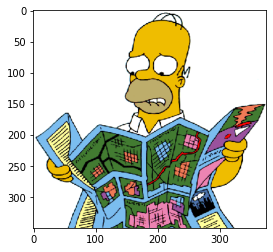

In [11]:
plt.imshow(image);

In [12]:
type(image)

PIL.Image.Image

In [13]:
image.size

(375, 350)

In [14]:
image = tf.keras.preprocessing.image.img_to_array(image)

In [15]:
type(image)

numpy.ndarray

In [16]:
image.shape

(350, 375, 3)

In [17]:
image = tf.keras.applications.inception_v3.preprocess_input(image)

In [18]:
image.min(), image.max()

(-1.0, 1.0)

# Neural Network Activations

In [19]:
image_batch = tf.expand_dims(image, axis = 0)
image_batch.shape

TensorShape([1, 350, 375, 3])

In [20]:
activations = deep_dream_model.predict(image_batch)

2021-12-09 23:59:16.650329: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)
2021-12-09 23:59:18.730623: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8005


In [21]:
len(activations)

4

# Error calculation (loss)

In [22]:
def calculate_error(image, network):
  image_batch = tf.expand_dims(image, axis = 0)
  activations = network(image_batch)
  mistakes = []
  for activation in activations:
    media = tf.math.reduce_mean(activation)
    mistakes.append(media)

  return tf.reduce_sum(mistakes)

In [23]:
loss = calculate_error(image, deep_dream_model)
loss

<tf.Tensor: shape=(), dtype=float32, numpy=0.90159655>

# Gradient climb

In [24]:
@tf.function
def deep_dream(network, image, learning_rate):
  with tf.GradientTape() as tape:
    tape.watch(image)
    mistakes = calculate_error(image, network)

  gradientes = tape.gradient(mistakes, image) 
  gradientes /= tf.math.reduce_std(gradientes)
  image = image + gradientes * learning_rate
  image = tf.clip_by_value(image, -1, 1)

  return mistakes, image

In [25]:
def convert_image(image):
  image = 255 * (image + 1.0) / 2.0
  return tf.cast(image, tf.uint8)

In [26]:
def run_deep_dream(network, image, epochs, learning_rate):
  for epoch in range(epochs):
    erro, image = deep_dream(network, image, learning_rate)
    if epoch % 200 == 0:
      plt.figure(figsize=(12,12))
      plt.imshow(convert_image(image))
      plt.show()
      print('Época {}, loss {}'.format(epoch, erro))

# Generation of Images

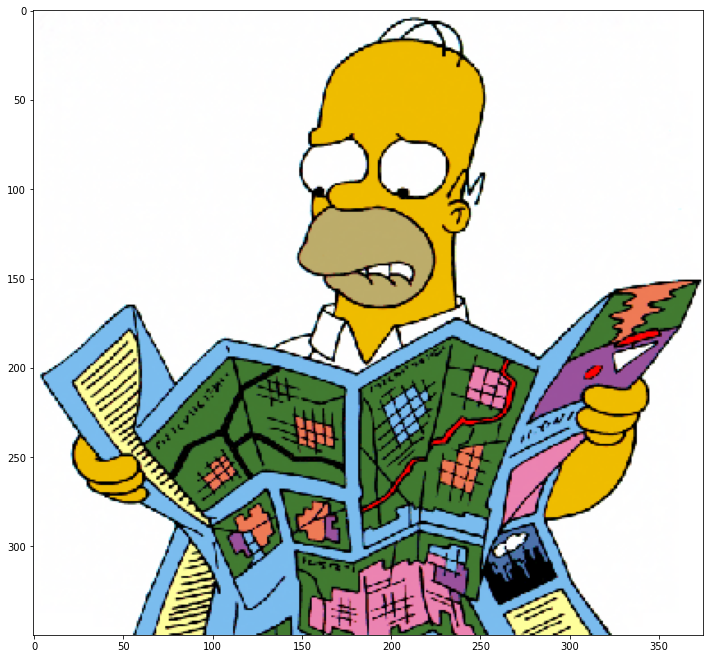

Época 0, loss 0.9015965461730957


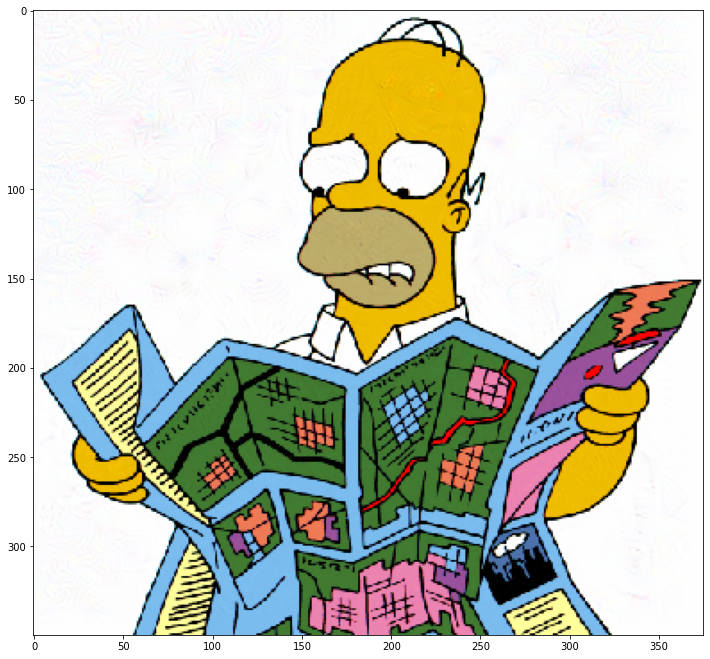

Época 200, loss 1.7389376163482666


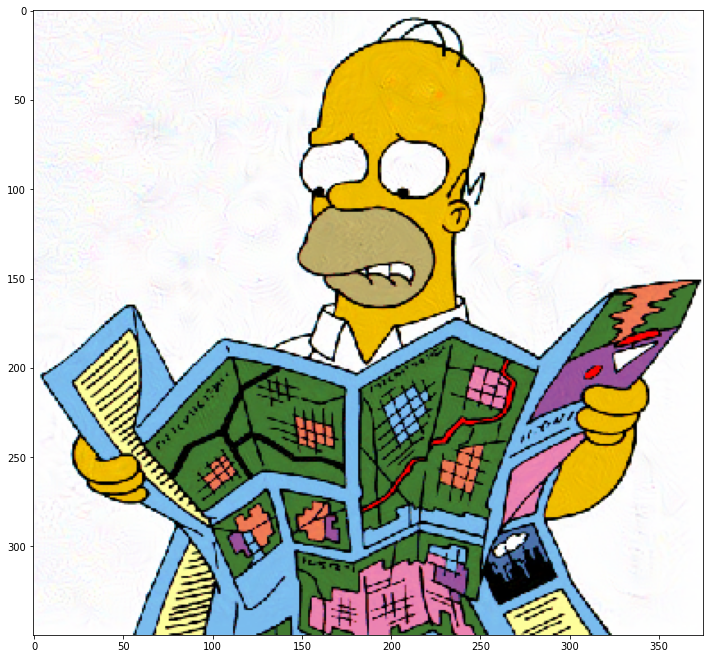

Época 400, loss 2.015850305557251


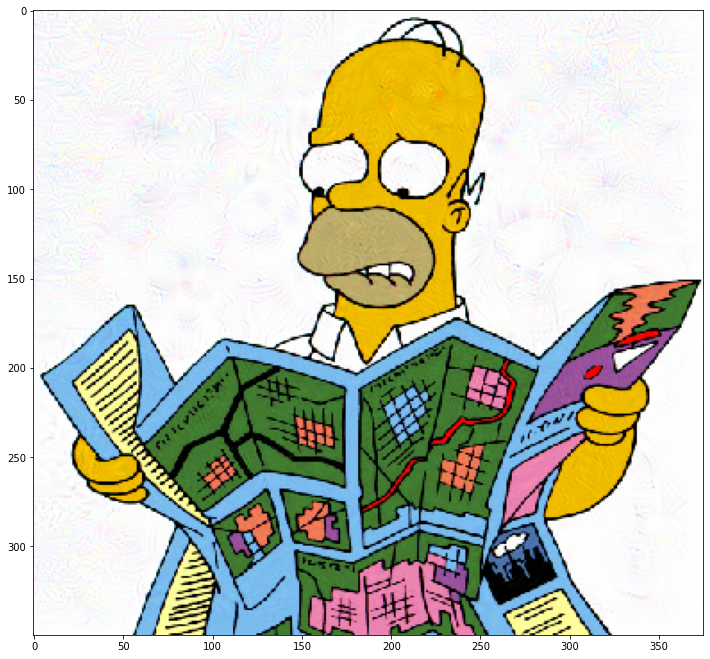

Época 600, loss 2.2101619243621826


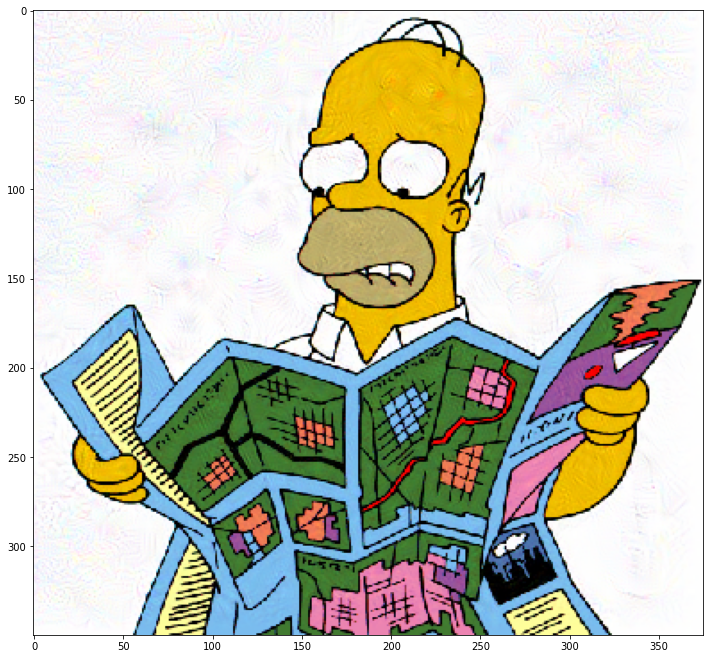

Época 800, loss 2.350938320159912


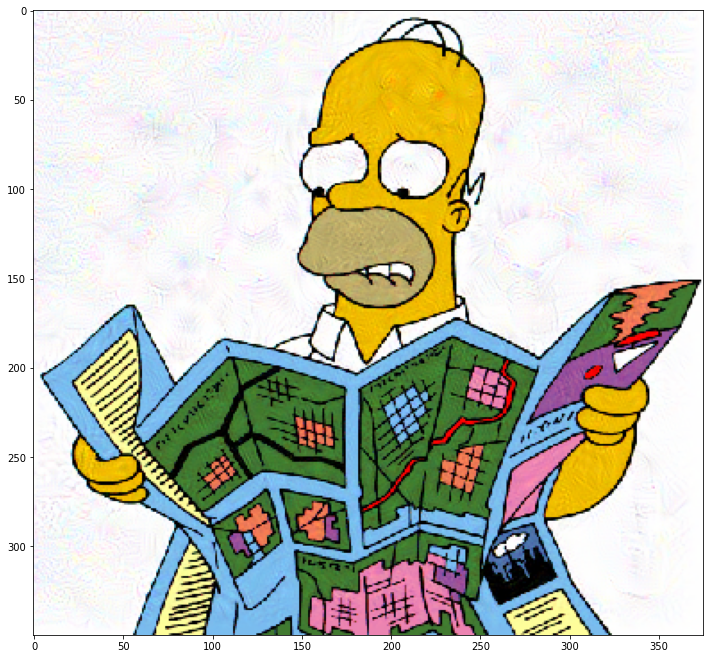

Época 1000, loss 2.4742727279663086


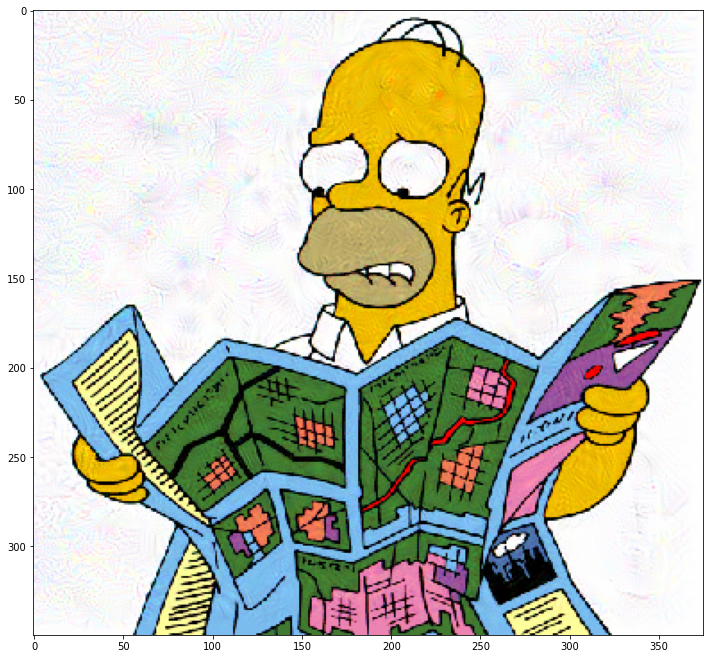

Época 1200, loss 2.566986322402954


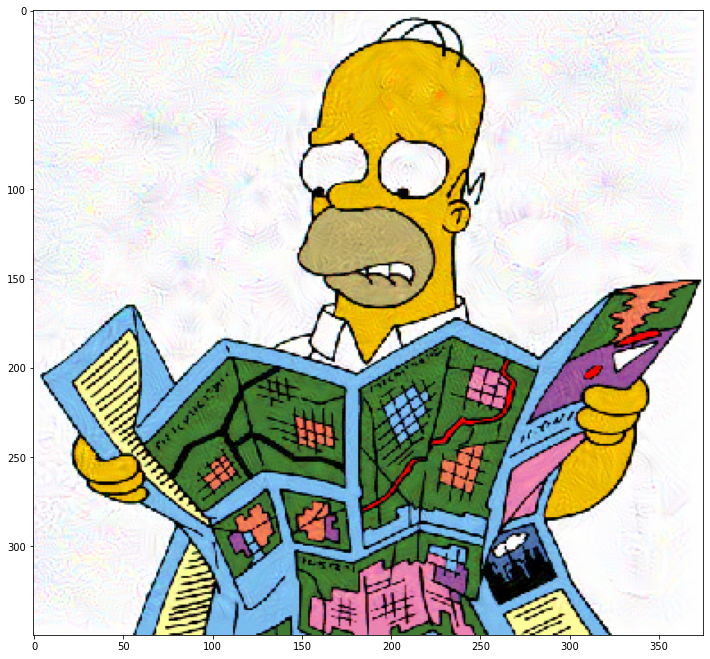

Época 1400, loss 2.6461236476898193


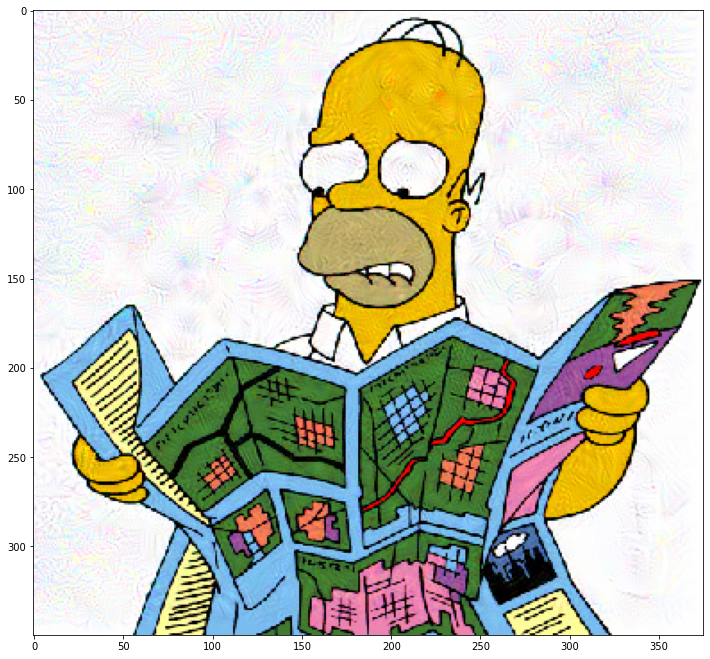

Época 1600, loss 2.719027280807495


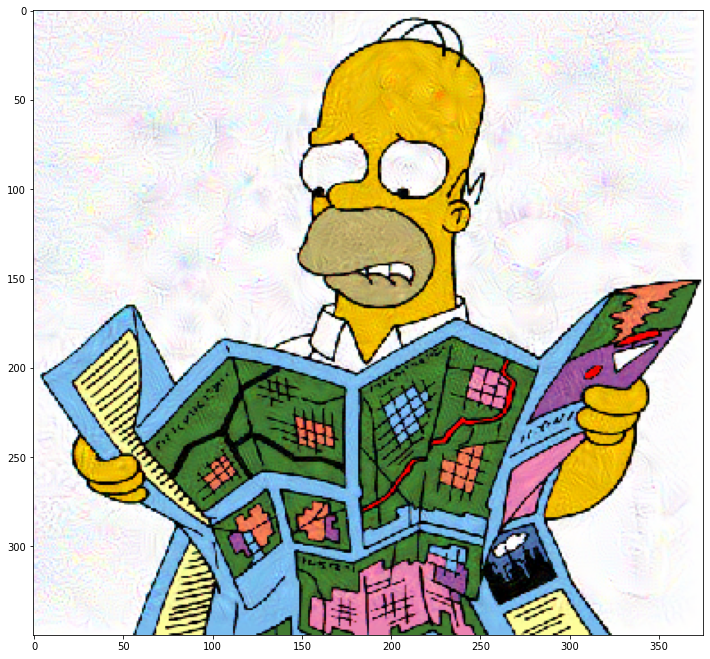

Época 1800, loss 2.7804694175720215


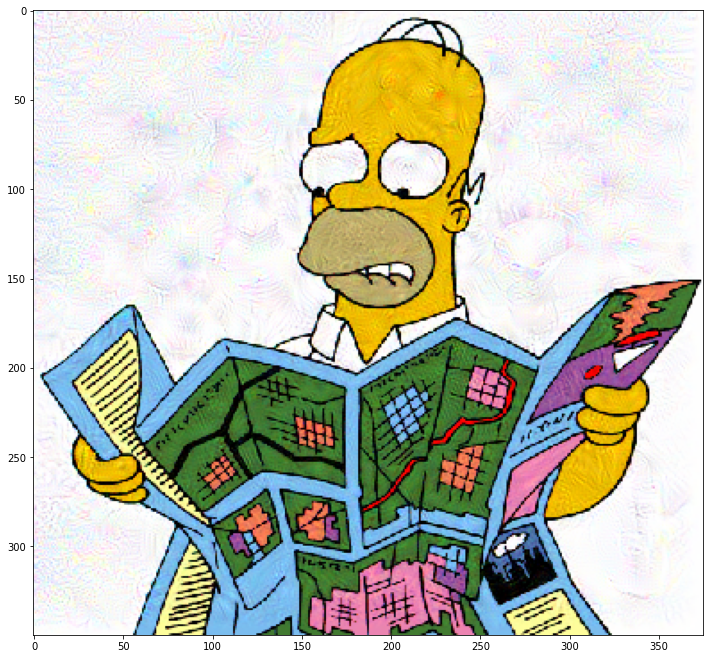

Época 2000, loss 2.8440542221069336


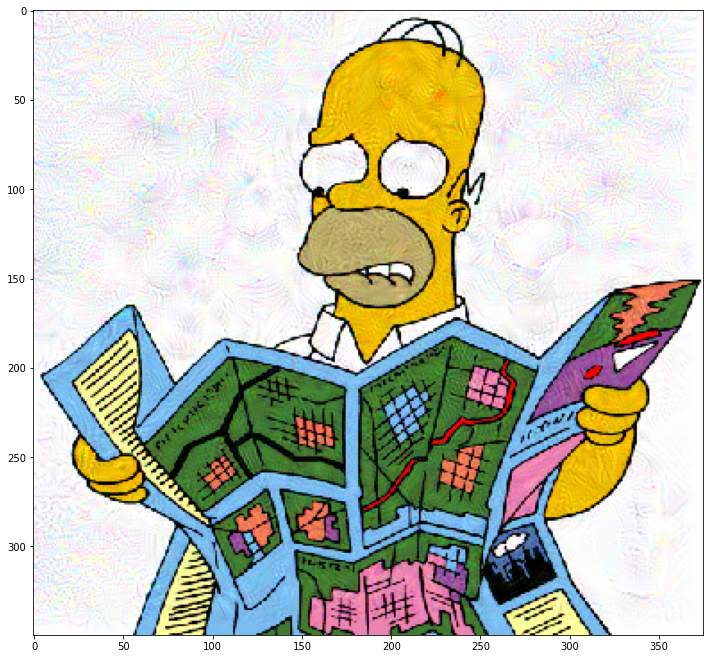

Época 2200, loss 2.8969454765319824


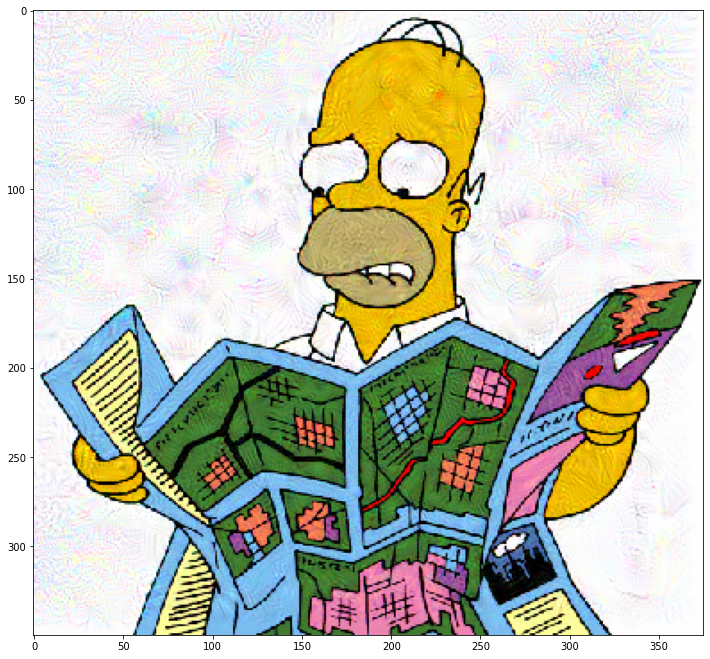

Época 2400, loss 2.9489879608154297


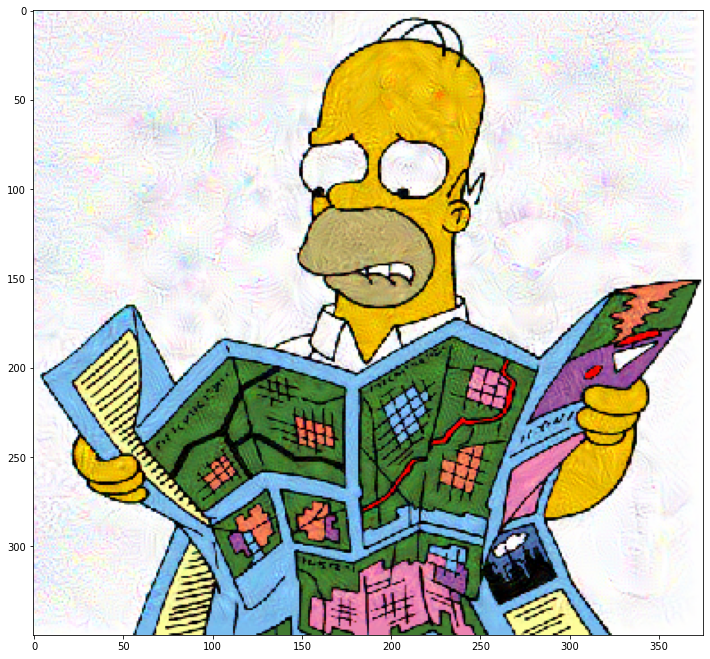

Época 2600, loss 3.0003232955932617


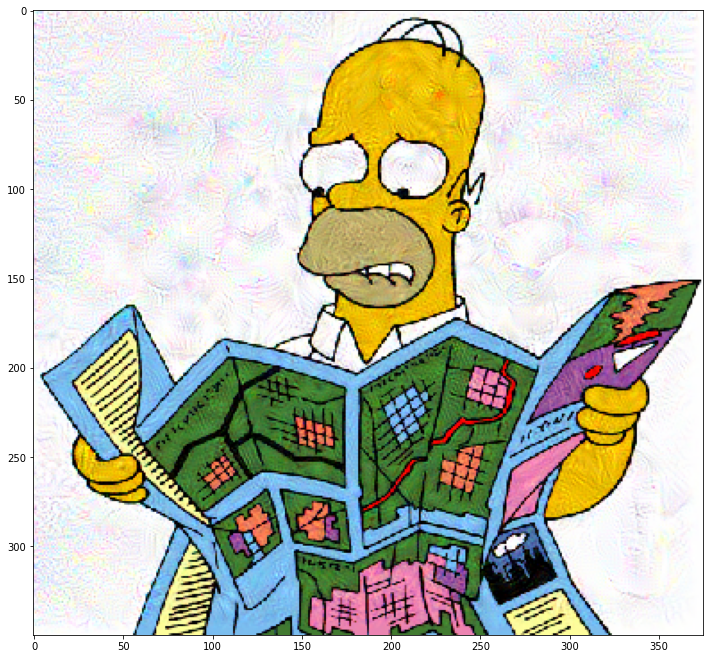

Época 2800, loss 3.047585964202881


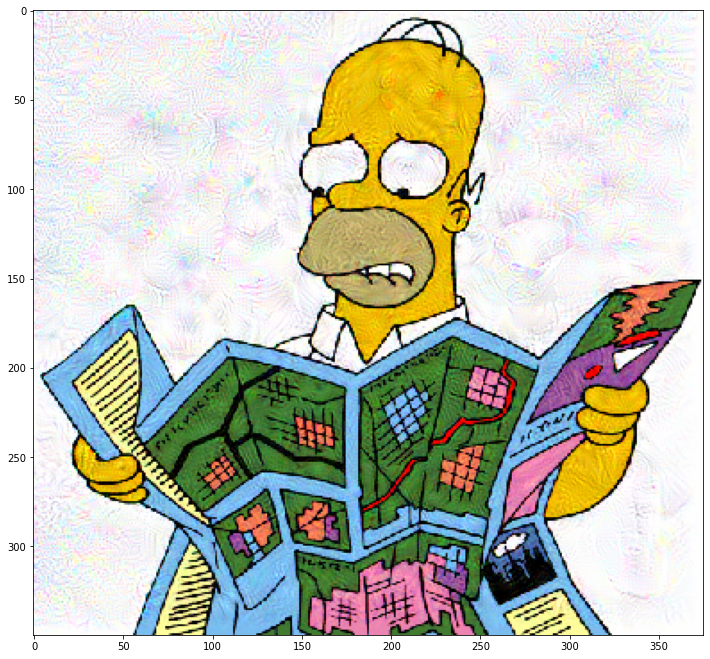

Época 3000, loss 3.0998482704162598


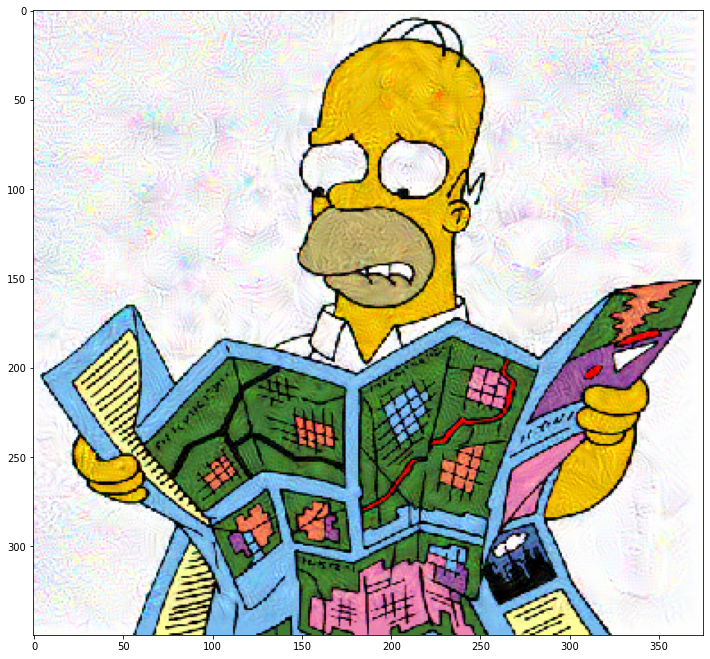

Época 3200, loss 3.1511785984039307


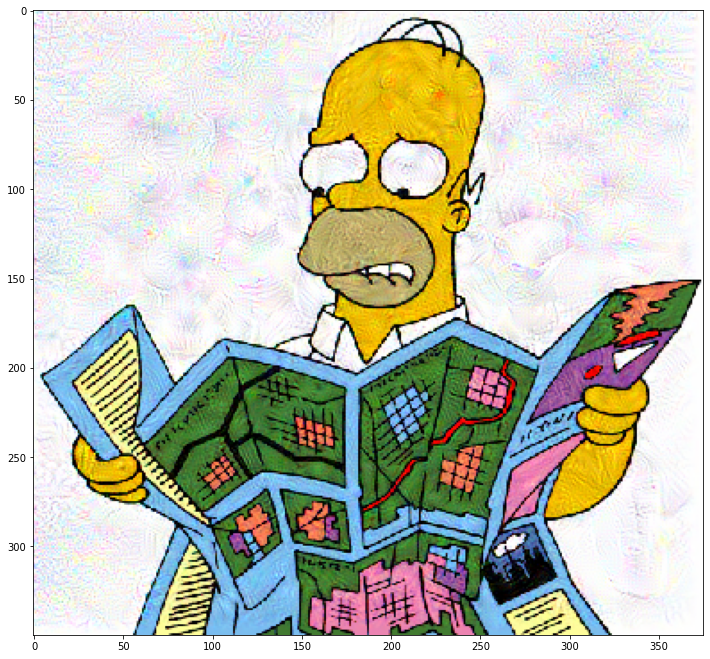

Época 3400, loss 3.19746732711792


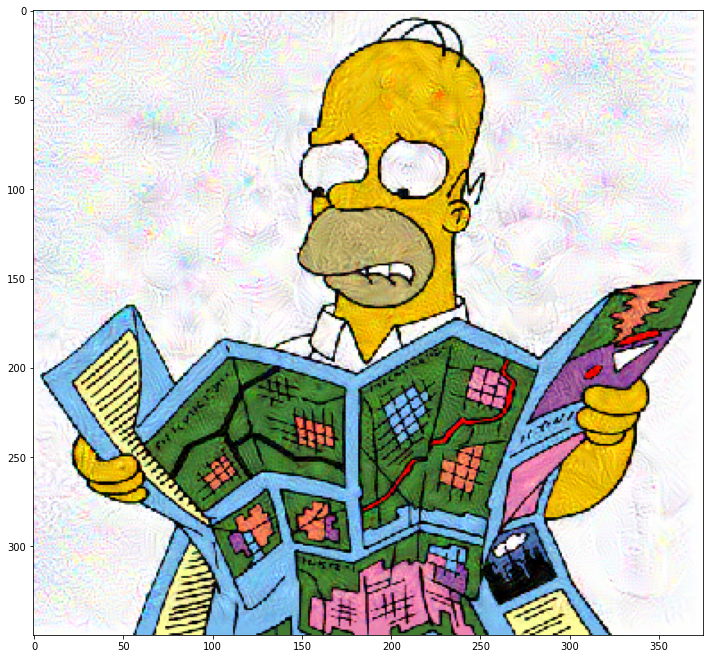

Época 3600, loss 3.245082378387451


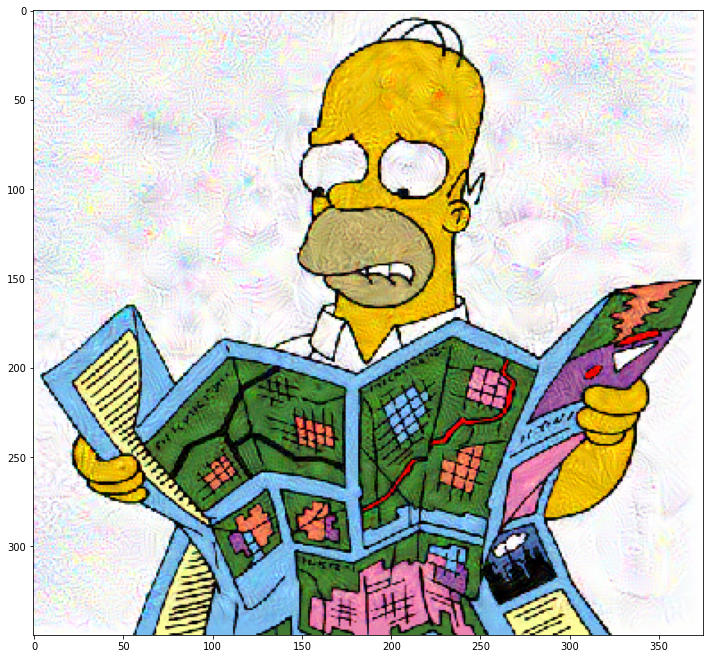

Época 3800, loss 3.2876479625701904


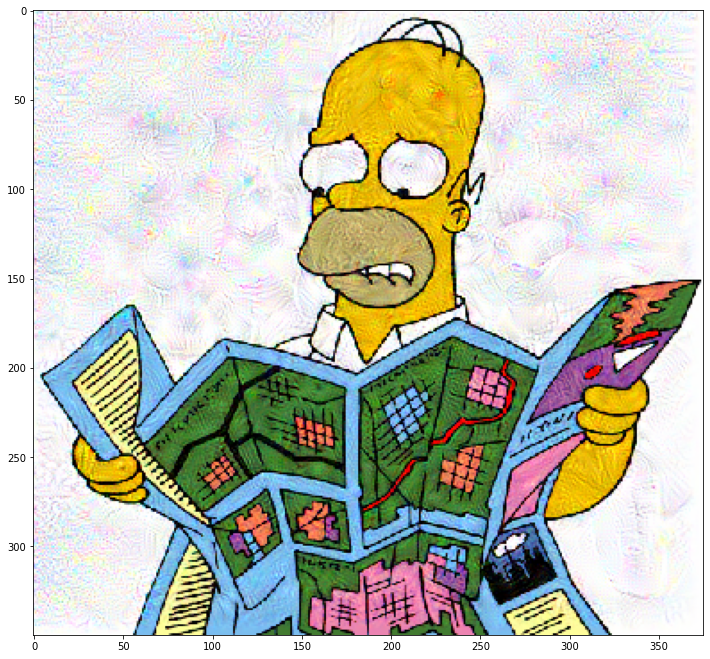

Época 4000, loss 3.336219549179077


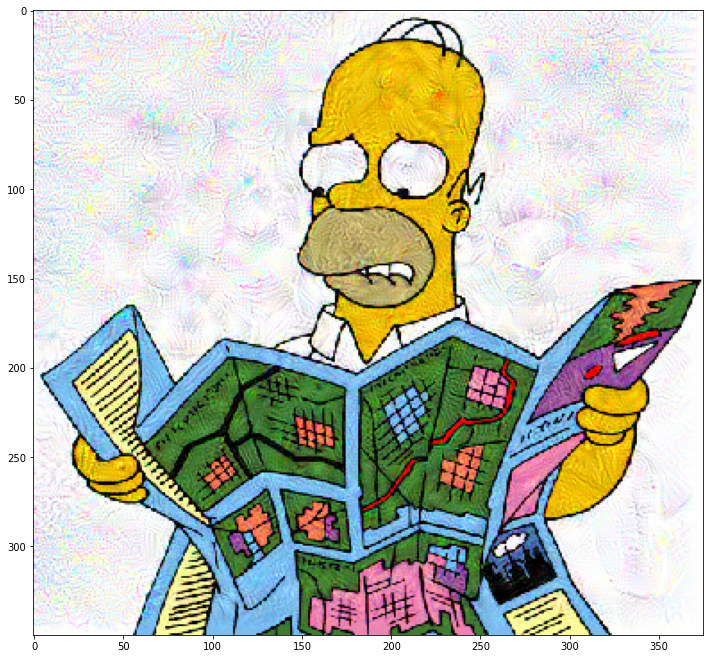

Época 4200, loss 3.3755924701690674


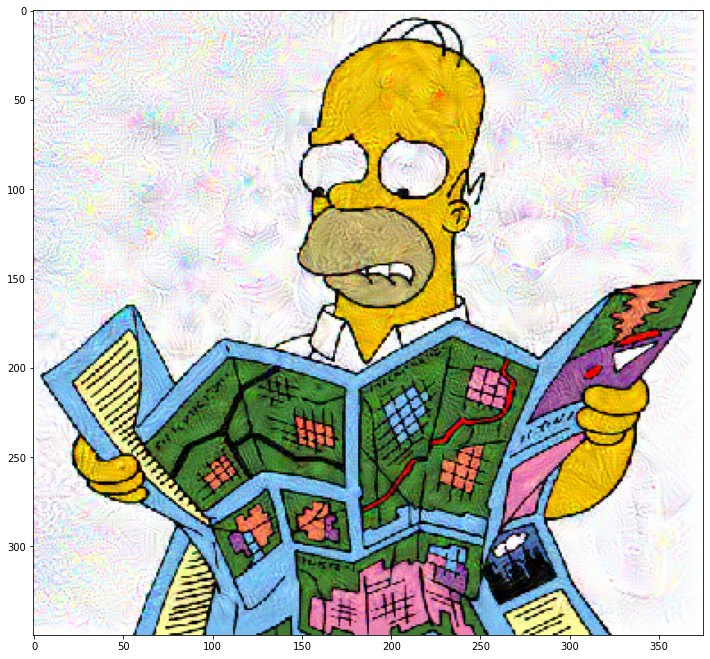

Época 4400, loss 3.4174132347106934


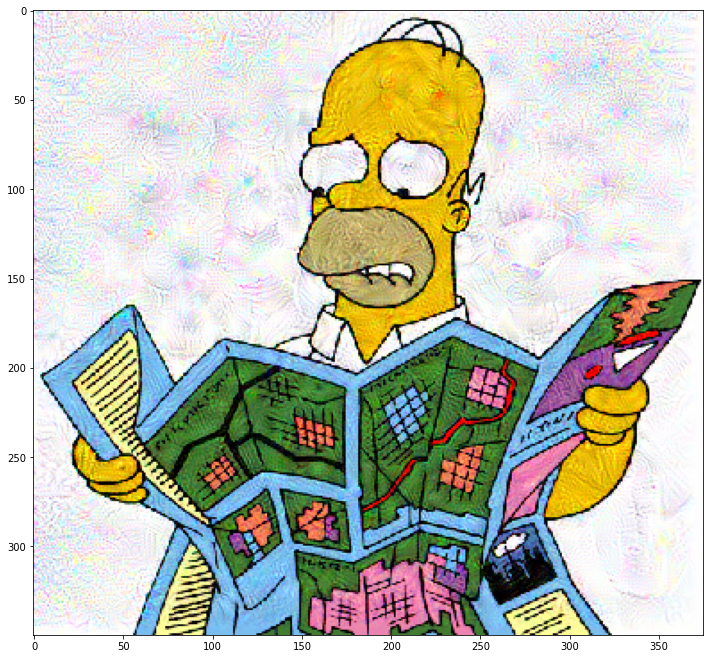

Época 4600, loss 3.4608163833618164


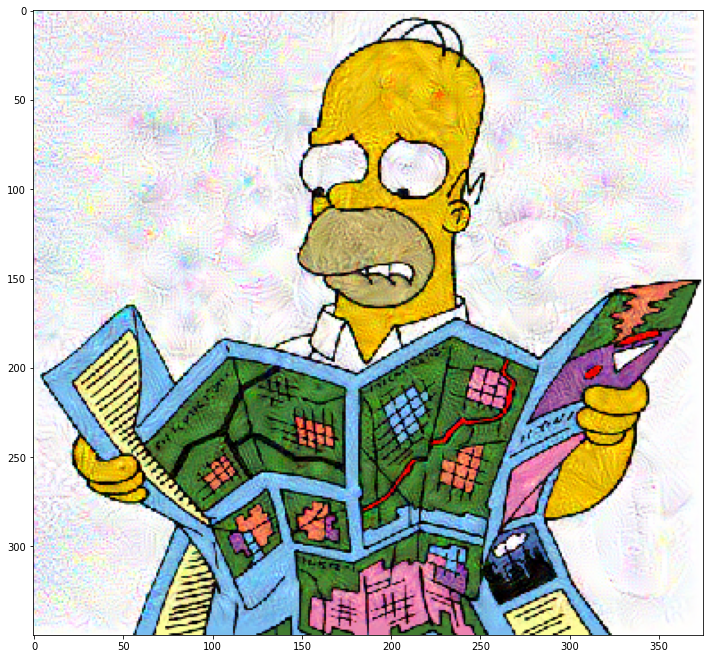

Época 4800, loss 3.502441167831421


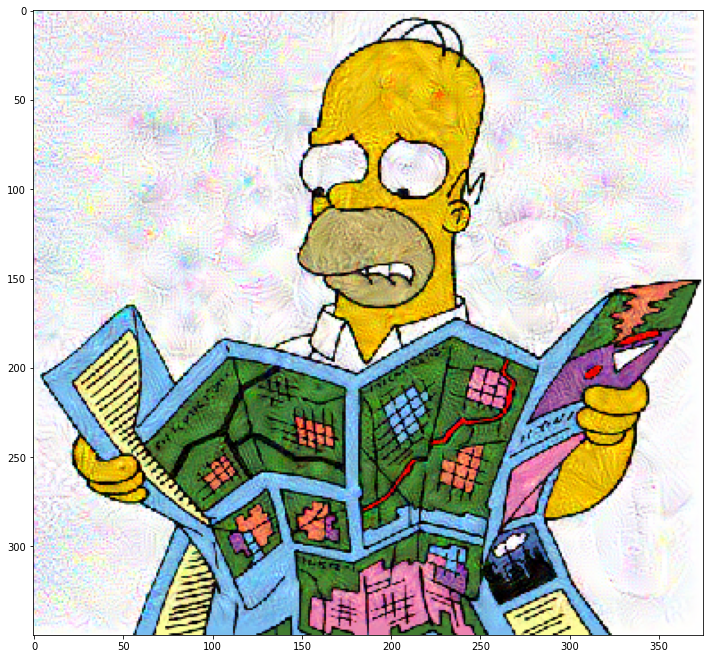

Época 5000, loss 3.539551019668579


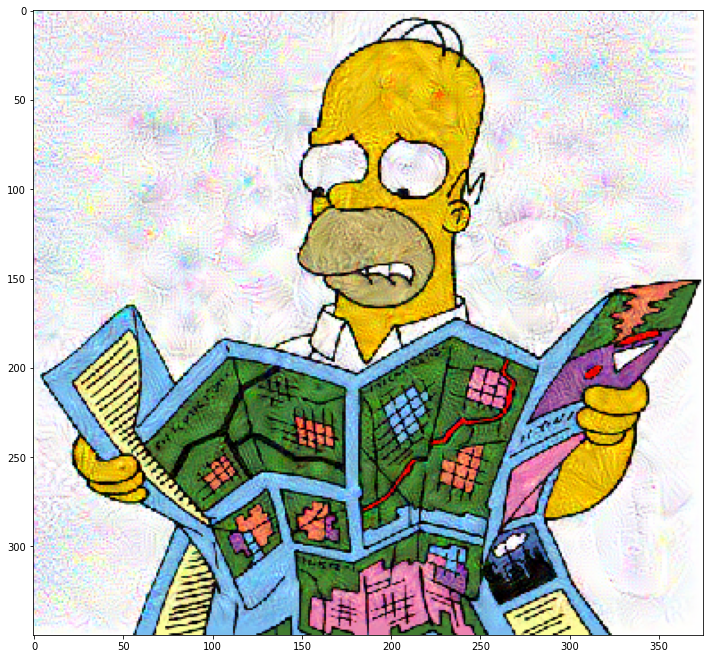

Época 5200, loss 3.5797762870788574


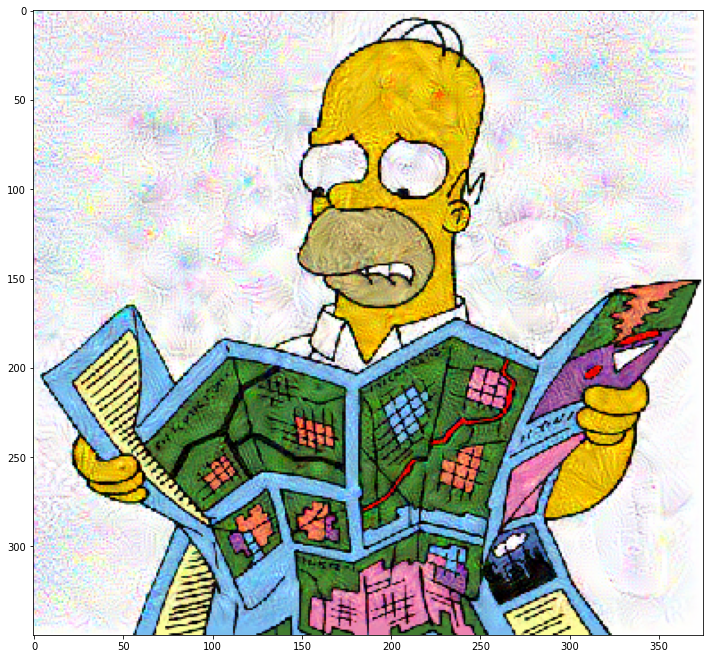

Época 5400, loss 3.615110397338867


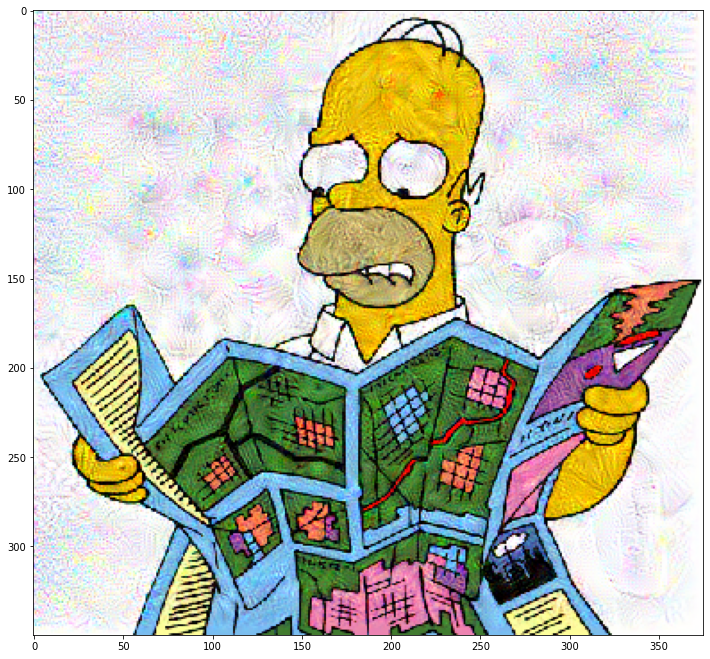

Época 5600, loss 3.654142379760742


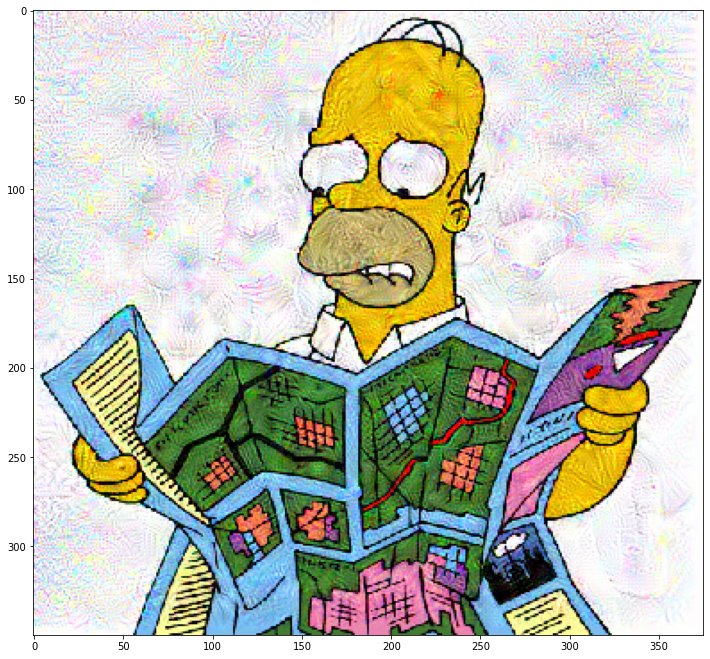

Época 5800, loss 3.687608480453491


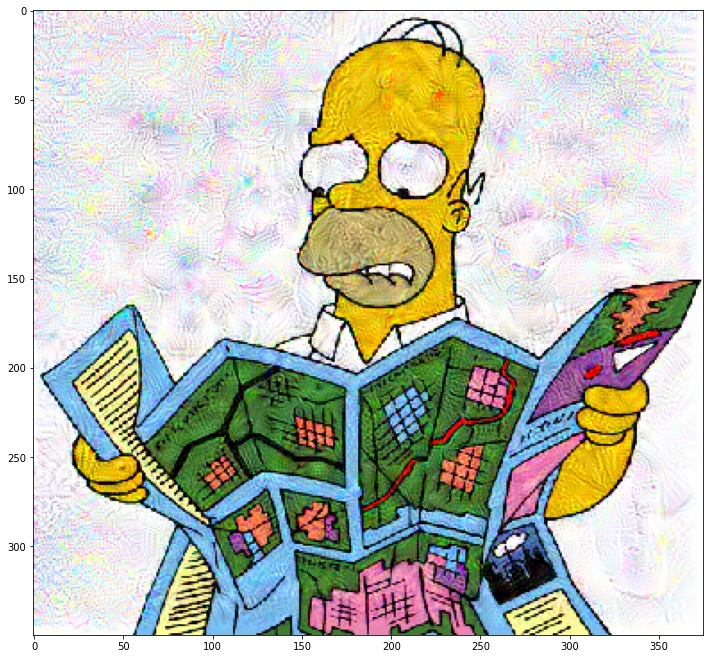

Época 6000, loss 3.720911979675293


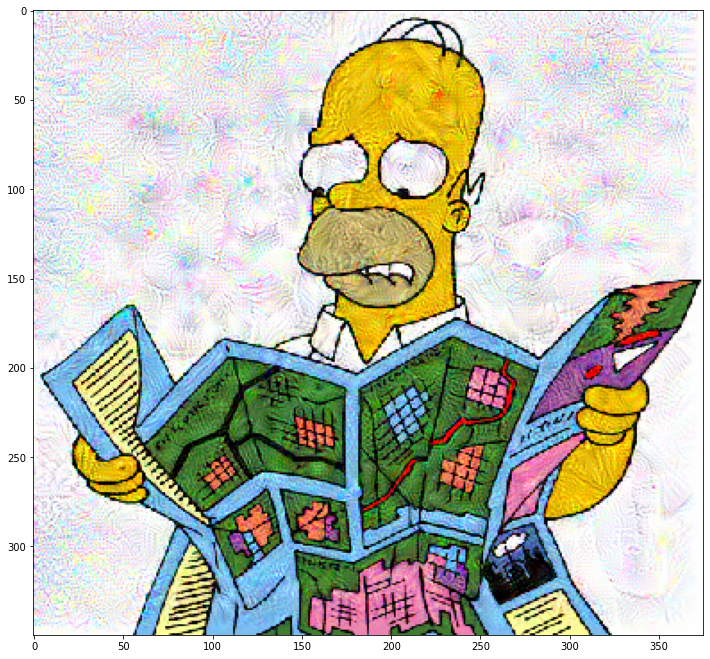

Época 6200, loss 3.7524168491363525


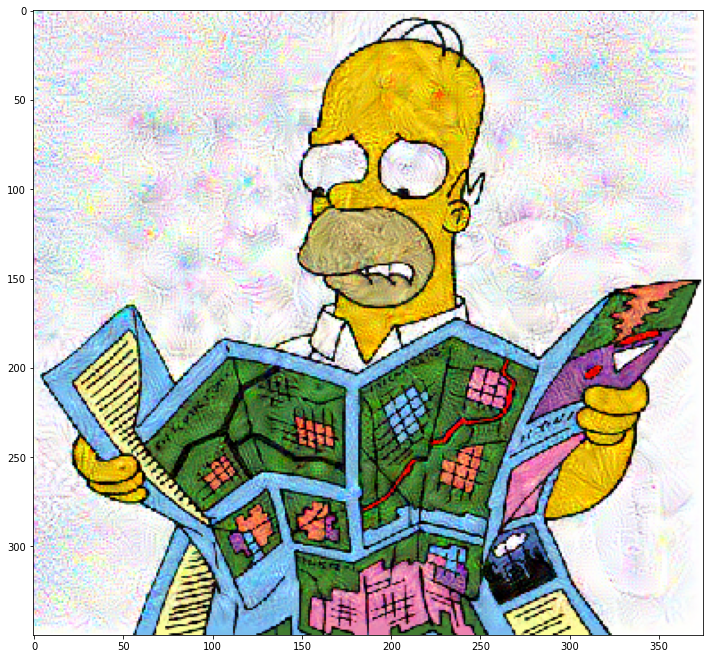

Época 6400, loss 3.785569667816162


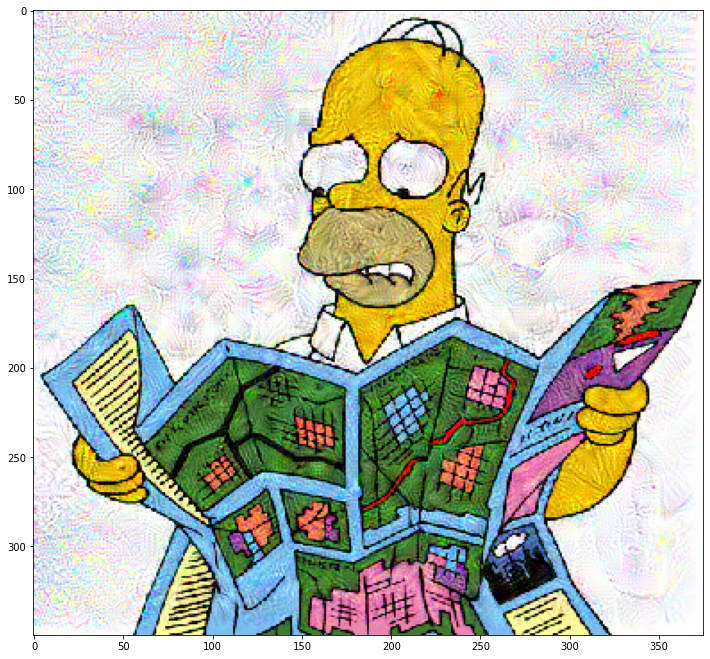

Época 6600, loss 3.8159055709838867


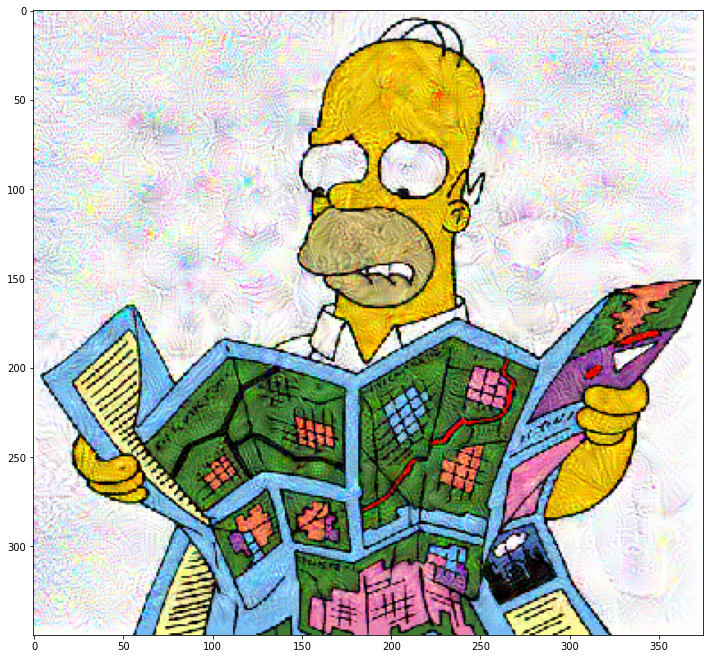

Época 6800, loss 3.8455145359039307


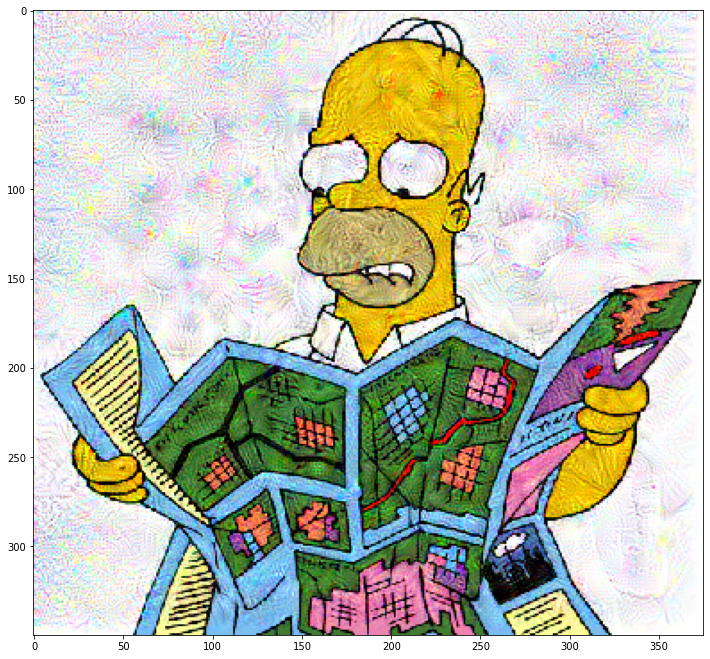

Época 7000, loss 3.8759613037109375


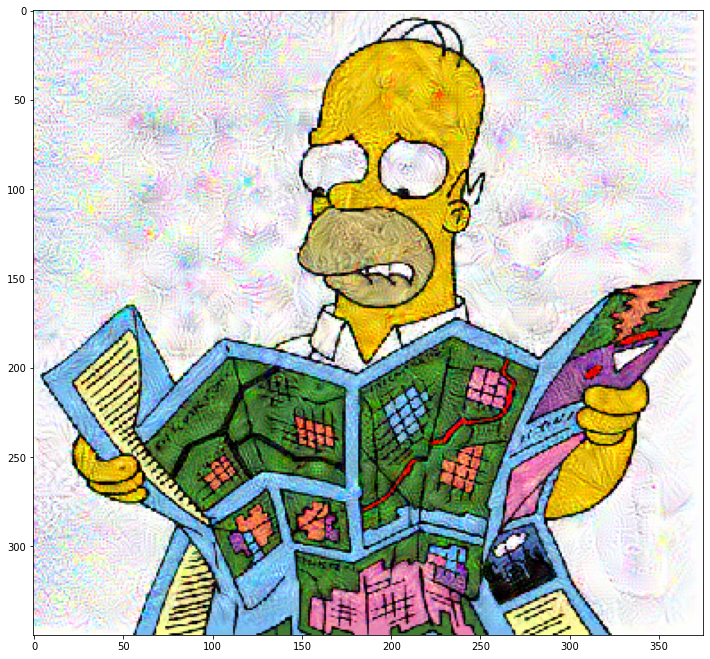

Época 7200, loss 3.9086356163024902


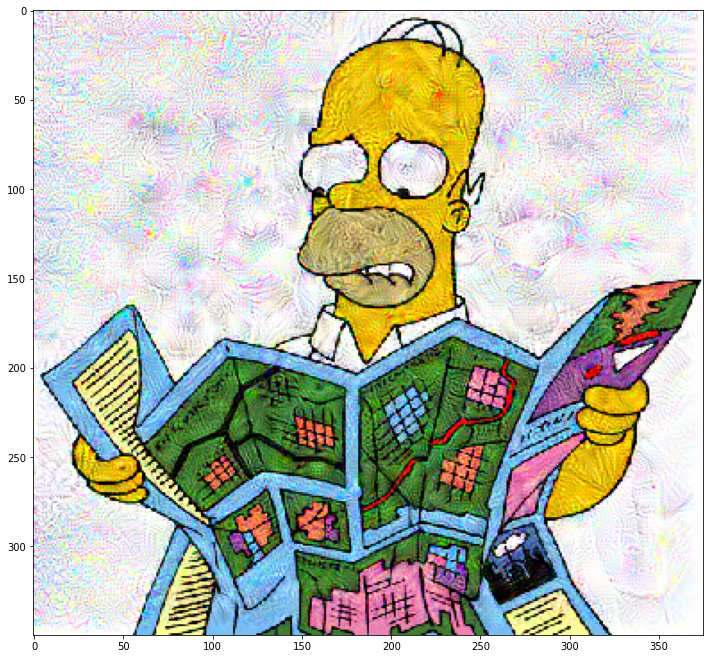

Época 7400, loss 3.931824207305908


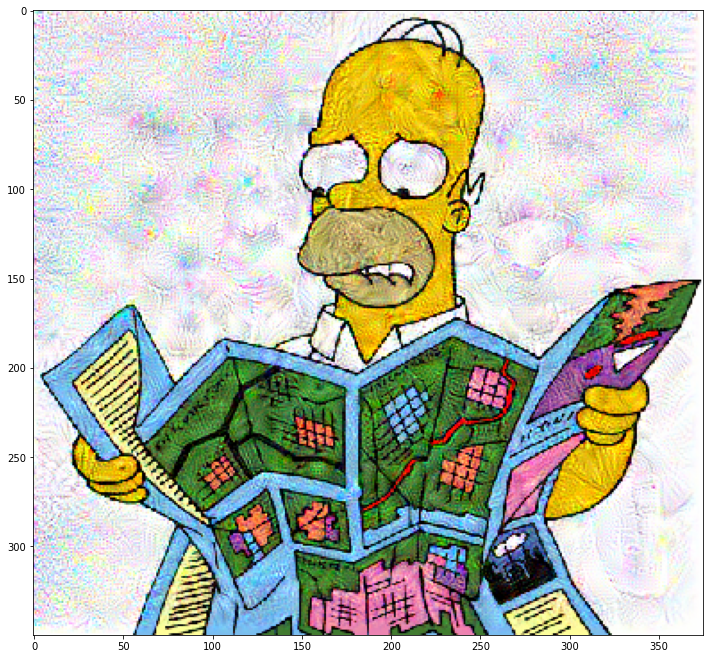

Época 7600, loss 3.9607763290405273


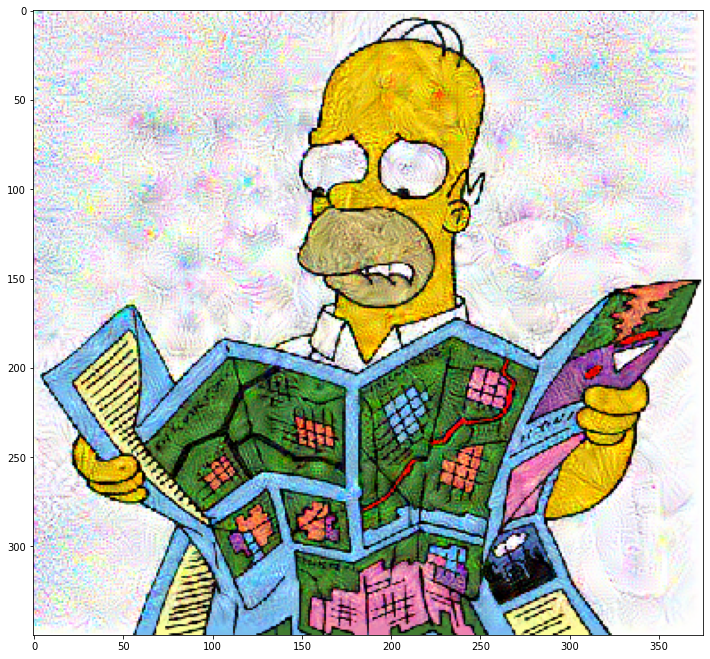

Época 7800, loss 3.9894888401031494


In [27]:
run_deep_dream(deep_dream_model, image, 8000, 0.001)

# **If you find this notebook useful, support with an upvote** 👍